# Prevendo o número de casos de COVID-19 em Pernambuco


In [1]:
# Bibliotecas

import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import sweetviz as sv
from pandas_profiling import ProfileReport
import pandas_profiling
from scipy import optimize
from datetime import datetime, timedelta
%matplotlib inline
import bar_chart_race as bcr

import warnings
warnings.filterwarnings('always')
warnings.filterwarnings('ignore')

# Dados

Fonte: https://brasil.io/dataset/covid19/boletim/

In [2]:
# Mostrar todas as colunas da base:
pd.set_option('display.max_columns', None)

# Ler a base de dados
df = pd.read_csv("caso_full.csv" , sep=',' , encoding='utf8') 

# Informações básicas
print(f'Registros: {len(df)}\nVariáveis: {len(df.columns)}')

Registros: 1061203
Variáveis: 18


In [3]:
df.head()

,city,city_ibge_code,date,epidemiological_week,estimated_population,estimated_population_2019,is_last,is_repeated,last_available_confirmed,last_available_confirmed_per_100k_inhabitants,last_available_date,last_available_death_rate,last_available_deaths,order_for_place,place_type,state,new_confirmed,new_deaths
0,São Paulo,3550308.0,2020-02-25,9,12325232.0,12252023.0,False,False,1,0.00811,2020-02-25,0.0,0,1,city,SP,1,0
1,NaN,35.0,2020-02-25,9,46289333.0,45919049.0,False,False,1,0.00216,2020-02-25,0.0,0,1,state,SP,1,0
2,São Paulo,3550308.0,2020-02-26,9,12325232.0,12252023.0,False,False,1,0.00811,2020-02-26,0.0,0,2,city,SP,0,0
3,NaN,35.0,2020-02-26,9,46289333.0,45919049.0,False,False,1,0.00216,2020-02-26,0.0,0,2,state,SP,0,0
4,São Paulo,3550308.0,2020-02-27,9,12325232.0,12252023.0,False,False,1,0.00811,2020-02-27,0.0,0,3,city,SP,0,0


In [4]:
df.sample(5).T

,310126,496678,493354,305134,12016
city,Flórida,Pedra Bonita,Mato Queimado,Jaçanã,São Vicente
city_ibge_code,4.10811e+06,3.14876e+06,4.31218e+06,2.40501e+06,3.55101e+06
date,2020-07-04,2020-08-07,2020-08-06,2020-07-03,2020-04-11
epidemiological_week,27,32,32,27,15
estimated_population,2699,7128,1629,9238,368355
estimated_population_2019,2689,7097,1648,9133,365798
is_last,False,False,False,False,False
is_repeated,False,False,False,False,False
last_available_confirmed,1,6,5,74,14
last_available_confirmed_per_100k_inhabitants,37.0508,84.1751,306.937,801.039,3.80068


In [5]:
df.tail()

,city,city_ibge_code,date,epidemiological_week,estimated_population,estimated_population_2019,is_last,is_repeated,last_available_confirmed,last_available_confirmed_per_100k_inhabitants,last_available_date,last_available_death_rate,last_available_deaths,order_for_place,place_type,state,new_confirmed,new_deaths
1061198,NaN,43.0,2020-11-15,47,11422973.0,11377239.0,True,False,278707,2439.88146,2020-11-15,0.0223,6219,251,state,RS,1188,4
1061199,NaN,42.0,2020-11-15,47,7252502.0,7164788.0,True,False,295946,4080.60556,2020-11-15,0.0112,3318,249,state,SC,2144,9
1061200,NaN,28.0,2020-11-15,47,2318822.0,2298696.0,True,False,86045,3710.72036,2020-11-15,0.0263,2259,247,state,SE,65,2
1061201,NaN,35.0,2020-11-15,47,46289333.0,45919049.0,True,False,1168640,2524.64212,2020-11-15,0.0347,40564,265,state,SP,1218,15
1061202,NaN,17.0,2020-11-15,47,1590248.0,1572866.0,False,True,78077,4909.73735,2020-11-14,0.0146,1137,243,state,TO,0,0


In [6]:
df

,city,city_ibge_code,date,epidemiological_week,estimated_population,estimated_population_2019,is_last,is_repeated,last_available_confirmed,last_available_confirmed_per_100k_inhabitants,last_available_date,last_available_death_rate,last_available_deaths,order_for_place,place_type,state,new_confirmed,new_deaths
0,São Paulo,3550308.0,2020-02-25,9,12325232.0,12252023.0,False,False,1,0.00811,2020-02-25,0.0000,0,1,city,SP,1,0
1,NaN,35.0,2020-02-25,9,46289333.0,45919049.0,False,False,1,0.00216,2020-02-25,0.0000,0,1,state,SP,1,0
2,São Paulo,3550308.0,2020-02-26,9,12325232.0,12252023.0,False,False,1,0.00811,2020-02-26,0.0000,0,2,city,SP,0,0
3,NaN,35.0,2020-02-26,9,46289333.0,45919049.0,False,False,1,0.00216,2020-02-26,0.0000,0,2,state,SP,0,0
4,São Paulo,3550308.0,2020-02-27,9,12325232.0,12252023.0,False,False,1,0.00811,2020-02-27,0.0000,0,3,city,SP,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1061198,NaN,43.0,2020-11-15,47,11422973.0,11377239.0,True,False,278707,2439.88146,2020-11-15,0.0223,6219,251,state,RS,1188,4
1061199,NaN,42.0,2020-11-15,47,7252502.0,7164788.0,True,False,295946,4080.60556,2020-11-15,0.0112,3318,249,state,SC,2144,9
1061200,NaN,28.0,2020-11-15,47,2318822.0,2298696.0,True,False,86045,3710.72036,2020-11-15,0.0263,2259,247,state,SE,65,2
1061201,NaN,35.0,2020-11-15,47,46289333.0,45919049.0,True,False,1168640,2524.64212,2020-11-15,0.0347,40564,265,state,SP,1218,15


In [7]:
# IBGE
cidades = pd.read_csv('cidades.csv', sep=',',encoding='utf8') 

In [8]:
# setar pelo codigo do ibge
cidades = cidades.set_index('codigo_ibge')

In [9]:
cidades.head()

,nome,latitude,longitude,capital,codigo_uf
codigo_ibge,,,,,
5200050,Abadia de Goiás,-16.75730,-49.4412,0,52
3100104,Abadia dos Dourados,-18.48310,-47.3916,0,31
5200100,Abadiânia,-16.19700,-48.7057,0,52
3100203,Abaeté,-19.15510,-45.4444,0,31
1500107,Abaetetuba,-1.72183,-48.8788,0,15


In [10]:
# Informação das coluna e uso de memoria
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1061203 entries, 0 to 1061202
Data columns (total 18 columns):
 #   Column                                         Non-Null Count    Dtype  
---  ------                                         --------------    -----  
 0   city                                           1054503 non-null  object 
 1   city_ibge_code                                 1057000 non-null  float64
 2   date                                           1061203 non-null  object 
 3   epidemiological_week                           1061203 non-null  int64  
 4   estimated_population                           1057000 non-null  float64
 5   estimated_population_2019                      1057000 non-null  float64
 6   is_last                                        1061203 non-null  bool   
 7   is_repeated                                    1061203 non-null  bool   
 8   last_available_confirmed                       1061203 non-null  int64  
 9   last_available_confirmed

In [11]:
# covertendo a coluna date para datetime
df.date=pd.to_datetime(df.date)
# Tipos da colunas
df.dtypes

city                                                     object
city_ibge_code                                          float64
date                                             datetime64[ns]
epidemiological_week                                      int64
estimated_population                                    float64
estimated_population_2019                               float64
is_last                                                    bool
is_repeated                                                bool
last_available_confirmed                                  int64
last_available_confirmed_per_100k_inhabitants           float64
last_available_date                                      object
last_available_death_rate                               float64
last_available_deaths                                     int64
order_for_place                                           int64
place_type                                               object
state                                   

# Pré-Processamento dos Dados


In [ ]:
# Pandas Profiling Relatório

profile = ProfileReport(df, title='Relatório Corona_Virus', html={'style':{'full_width':True}})

profile.to_notebook_iframe()

profile.to_file(output_file="Relatório Corona_Virus")

In [ ]:
## ## Sweetviz  Relatório
my_report = sv.analyze(df) # cria o reporte e chama de my_report
my_report.show_html()

# sv.anlyze(df).show_html()

In [12]:
# Número de linhas e coluna:
df.shape

(1061203, 18)

In [13]:
# Numero de celulas
df.size

19101654

In [14]:
# retorna a quantidade de linha de todas as colunas
df.count()

city                                             1054503
city_ibge_code                                   1057000
date                                             1061203
epidemiological_week                             1061203
estimated_population                             1057000
estimated_population_2019                        1057000
is_last                                          1061203
is_repeated                                      1061203
last_available_confirmed                         1061203
last_available_confirmed_per_100k_inhabitants    1042766
last_available_date                              1061203
last_available_death_rate                        1061203
last_available_deaths                            1061203
order_for_place                                  1061203
place_type                                       1061203
state                                            1061203
new_confirmed                                    1061203
new_deaths                     

In [15]:
# todas colunas
df.columns.values

array(['city', 'city_ibge_code', 'date', 'epidemiological_week',
       'estimated_population', 'estimated_population_2019', 'is_last',
       'is_repeated', 'last_available_confirmed',
       'last_available_confirmed_per_100k_inhabitants',
       'last_available_date', 'last_available_death_rate',
       'last_available_deaths', 'order_for_place', 'place_type', 'state',
       'new_confirmed', 'new_deaths'], dtype=object)

In [16]:
# transforma as colunas em lista
df.columns.tolist()

['city',
 'city_ibge_code',
 'date',
 'epidemiological_week',
 'estimated_population',
 'estimated_population_2019',
 'is_last',
 'is_repeated',
 'last_available_confirmed',
 'last_available_confirmed_per_100k_inhabitants',
 'last_available_date',
 'last_available_death_rate',
 'last_available_deaths',
 'order_for_place',
 'place_type',
 'state',
 'new_confirmed',
 'new_deaths']

In [17]:
# Consultando linhas com valore faltantes.
df.isnull().sum().sort_values(ascending=False)

last_available_confirmed_per_100k_inhabitants    18437
city                                              6700
city_ibge_code                                    4203
estimated_population                              4203
estimated_population_2019                         4203
is_repeated                                          0
date                                                 0
epidemiological_week                                 0
is_last                                              0
new_deaths                                           0
new_confirmed                                        0
last_available_date                                  0
last_available_death_rate                            0
last_available_deaths                                0
order_for_place                                      0
place_type                                           0
state                                                0
last_available_confirmed                             0
dtype: int

In [18]:
# contagem de missing em porcentagem
df.isna().mean()

city                                             0.006314
city_ibge_code                                   0.003961
date                                             0.000000
epidemiological_week                             0.000000
estimated_population                             0.003961
estimated_population_2019                        0.003961
is_last                                          0.000000
is_repeated                                      0.000000
last_available_confirmed                         0.000000
last_available_confirmed_per_100k_inhabitants    0.017374
last_available_date                              0.000000
last_available_death_rate                        0.000000
last_available_deaths                            0.000000
order_for_place                                  0.000000
place_type                                       0.000000
state                                            0.000000
new_confirmed                                    0.000000
new_deaths    

In [19]:
# Verificando a quantidade de valores nulos no dataset.
total = df.isnull().sum().sort_values(ascending=False)
percent = df.isnull().sum()/df.isnull().count().sort_values(ascending=False)
missing_data = pd.concat([total, percent], axis=1, sort=False, keys=['total', 'percent'])
missing_data[missing_data['percent']!=0]

,total,percent
last_available_confirmed_per_100k_inhabitants,18437,0.017374
city,6700,0.006314
city_ibge_code,4203,0.003961
estimated_population,4203,0.003961
estimated_population_2019,4203,0.003961


In [20]:
#Removendo duplicatas se houver
df.drop_duplicates(keep=False, inplace=True)

In [21]:
# é ou não é missing?
df.isna()

,city,city_ibge_code,date,epidemiological_week,estimated_population,estimated_population_2019,is_last,is_repeated,last_available_confirmed,last_available_confirmed_per_100k_inhabitants,last_available_date,last_available_death_rate,last_available_deaths,order_for_place,place_type,state,new_confirmed,new_deaths
0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
1,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
2,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
3,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
4,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1061198,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
1061199,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
1061200,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
1061201,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False


In [22]:
df.describe().round(2)

,city_ibge_code,epidemiological_week,estimated_population,estimated_population_2019,last_available_confirmed,last_available_confirmed_per_100k_inhabitants,last_available_death_rate,last_available_deaths,order_for_place,new_confirmed,new_deaths
count,1057000.00,1061203.00,1057000.00,1057000.00,1061203.00,1042766.00,1061203.00,1061203.00,1061203.00,1061203.00,1061203.00
mean,3203489.74,32.80,95719.24,94984.29,1090.63,1115.97,0.03,35.40,97.42,10.83,0.31
std,1013624.95,8.34,1009647.20,1002347.92,13558.64,1402.45,0.09,510.49,58.36,144.22,4.64
min,11.00,9.00,776.00,781.00,0.00,0.00,0.00,0.00,1.00,-6791.00,-187.00
25%,2505105.00,26.00,6054.00,6029.00,13.00,143.52,0.00,0.00,48.00,0.00,0.00
50%,3141603.00,33.00,13413.00,13317.00,65.00,646.41,0.02,1.00,95.00,0.00,0.00
75%,4113908.00,40.00,29779.00,29551.00,275.00,1576.76,0.03,6.00,143.00,2.00,0.00
max,5300108.00,47.00,46289333.00,45919049.00,1168640.00,22397.89,1.00,40564.00,265.00,30913.00,455.00


In [23]:
# Variáveis categóricas:
df.describe(include=['O'])

,city,last_available_date,place_type,state
count,1054503,1061203,1061203,1061203
unique,5297,265,2,27
top,Importados/Indefinidos,2020-08-10,city,MG
freq,4203,19298,1054503,149725


In [24]:
df.describe(include=['object'])

,city,last_available_date,place_type,state
count,1054503,1061203,1061203,1061203
unique,5297,265,2,27
top,Importados/Indefinidos,2020-08-10,city,MG
freq,4203,19298,1054503,149725


In [25]:
#Matriz de correlação - person
df.corr().round(4)

,city_ibge_code,epidemiological_week,estimated_population,estimated_population_2019,is_last,is_repeated,last_available_confirmed,last_available_confirmed_per_100k_inhabitants,last_available_death_rate,last_available_deaths,order_for_place,new_confirmed,new_deaths
city_ibge_code,1.0000,0.0425,-0.1567,-0.1567,0.0025,0.0671,-0.1312,-0.1633,-0.0174,-0.1143,-0.0426,-0.1226,-0.1080
epidemiological_week,0.0425,1.0000,-0.0388,-0.0388,0.1116,0.2639,0.0472,0.5092,-0.1339,0.0325,0.8784,-0.0046,-0.0200
estimated_population,-0.1567,-0.0388,1.0000,1.0000,-0.0014,-0.0135,0.7118,0.0017,0.0058,0.7307,0.0388,0.6765,0.7028
estimated_population_2019,-0.1567,-0.0388,1.0000,1.0000,-0.0014,-0.0135,0.7116,0.0016,0.0058,0.7307,0.0388,0.6763,0.7028
is_last,0.0025,0.1116,-0.0014,-0.0014,1.0000,-0.0217,0.0051,0.0553,-0.0077,0.0033,0.1059,-0.0024,-0.0031
is_repeated,0.0671,0.2639,-0.0135,-0.0135,-0.0217,1.0000,-0.0049,0.1139,-0.0230,-0.0046,0.2421,-0.0224,-0.0198
last_available_confirmed,-0.1312,0.0472,0.7118,0.7116,0.0051,-0.0049,1.0000,0.0799,-0.0021,0.9333,0.1123,0.6527,0.5589
last_available_confirmed_per_100k_inhabitants,-0.1633,0.5092,0.0017,0.0016,0.0553,0.1139,0.0799,1.0000,-0.1248,0.0466,0.5670,0.0316,0.0091
last_available_death_rate,-0.0174,-0.1339,0.0058,0.0058,-0.0077,-0.0230,-0.0021,-0.1248,1.0000,0.0084,-0.0958,-0.0005,0.0134
last_available_deaths,-0.1143,0.0325,0.7307,0.7307,0.0033,-0.0046,0.9333,0.0466,0.0084,1.0000,0.0930,0.6350,0.6264


In [26]:
# Correlação de spearman - leva em consideração  a correlação positiva e negativa
df.corr('spearman').round(4)

,city_ibge_code,epidemiological_week,estimated_population,estimated_population_2019,is_last,is_repeated,last_available_confirmed,last_available_confirmed_per_100k_inhabitants,last_available_death_rate,last_available_deaths,order_for_place,new_confirmed,new_deaths
city_ibge_code,1.0000,0.0359,-0.1479,-0.1480,0.0022,0.0612,-0.1727,-0.1262,-0.0757,-0.1654,-0.0359,-0.0705,-0.0466
epidemiological_week,0.0359,1.0000,-0.1443,-0.1442,0.1148,0.2717,0.5163,0.7075,0.1726,0.3844,0.8870,-0.0532,-0.0431
estimated_population,-0.1479,-0.1443,1.0000,1.0000,-0.0075,-0.0438,0.5300,0.0207,0.2768,0.5644,0.1444,0.4179,0.2828
estimated_population_2019,-0.1480,-0.1442,1.0000,1.0000,-0.0074,-0.0440,0.5296,0.0202,0.2770,0.5642,0.1443,0.4177,0.2827
is_last,0.0022,0.1148,-0.0075,-0.0074,1.0000,-0.0217,0.0428,0.0611,0.0149,0.0351,0.0971,-0.0171,-0.0067
is_repeated,0.0612,0.2717,-0.0438,-0.0440,-0.0217,1.0000,0.1010,0.1559,0.0473,0.0845,0.2330,-0.2168,-0.0754
last_available_confirmed,-0.1727,0.5163,0.5300,0.5296,0.0428,0.1010,1.0000,0.8218,0.3677,0.8393,0.7197,0.4323,0.2629
last_available_confirmed_per_100k_inhabitants,-0.1262,0.7075,0.0207,0.0202,0.0611,0.1559,0.8218,1.0000,0.1961,0.6102,0.7615,0.2001,0.0869
last_available_death_rate,-0.0757,0.1726,0.2768,0.2770,0.0149,0.0473,0.3677,0.1961,1.0000,0.7230,0.3048,0.1637,0.1983
last_available_deaths,-0.1654,0.3844,0.5644,0.5642,0.0351,0.0845,0.8393,0.6102,0.7230,1.0000,0.6051,0.3800,0.3098


In [27]:
# selecionar apenas colunas de objeto
df.select_dtypes(include='object').head()

,city,last_available_date,place_type,state
0,São Paulo,2020-02-25,city,SP
1,NaN,2020-02-25,state,SP
2,São Paulo,2020-02-26,city,SP
3,NaN,2020-02-26,state,SP
4,São Paulo,2020-02-27,city,SP


In [28]:
# Selecionar as colunas numéricas
df.select_dtypes(include='number').head()

,city_ibge_code,epidemiological_week,estimated_population,estimated_population_2019,last_available_confirmed,last_available_confirmed_per_100k_inhabitants,last_available_death_rate,last_available_deaths,order_for_place,new_confirmed,new_deaths
0,3550308.0,9,12325232.0,12252023.0,1,0.00811,0.0,0,1,1,0
1,35.0,9,46289333.0,45919049.0,1,0.00216,0.0,0,1,1,0
2,3550308.0,9,12325232.0,12252023.0,1,0.00811,0.0,0,2,0,0
3,35.0,9,46289333.0,45919049.0,1,0.00216,0.0,0,2,0,0
4,3550308.0,9,12325232.0,12252023.0,1,0.00811,0.0,0,3,0,0


In [29]:
# selecionar vários tipos de dados
df.select_dtypes(include=['int', 'datetime', 'object']).head()

,city,date,last_available_date,place_type,state
0,São Paulo,2020-02-25,2020-02-25,city,SP
1,NaN,2020-02-25,2020-02-25,state,SP
2,São Paulo,2020-02-26,2020-02-26,city,SP
3,NaN,2020-02-26,2020-02-26,state,SP
4,São Paulo,2020-02-27,2020-02-27,city,SP


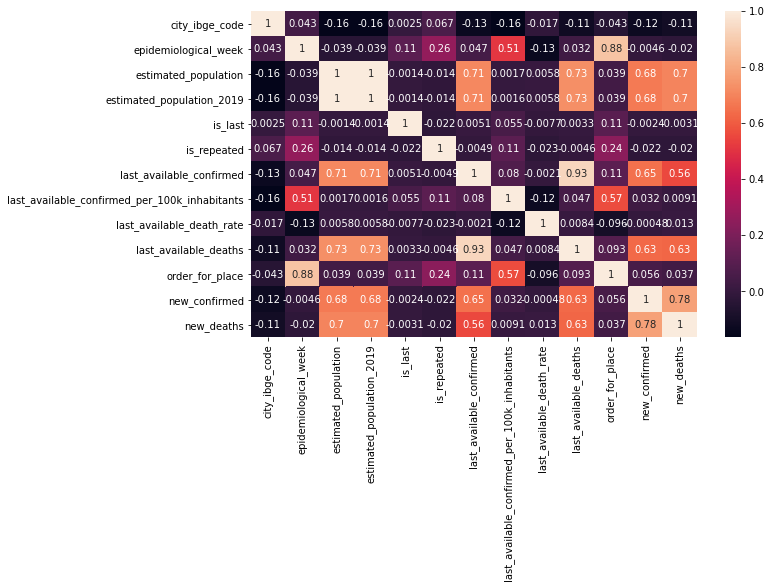

In [30]:
# Mapa de calor
plt.figure(figsize=(10,6))
sns.heatmap(df.corr(),annot=True);

In [117]:
# distribuição por estados
df["state"].value_counts()

MG    149725
SP    127364
RS     87716
BA     78372
PR     73190
SC     57036
GO     43773
MA     43242
PB     42246
PI     40638
CE     39292
PE     38622
RN     33000
PA     30206
TO     26186
MT     25923
RJ     20734
AL     20432
ES     17194
SE     15151
MS     14617
AM     13309
RO     10549
AC      4719
AP      3612
RR      3612
DF       743
Name: state, dtype: int64

In [31]:
# tamanho do banco
len(df)

1061203

In [32]:
# Seleciona todos os estados
estados =df.loc[df.place_type=='state',:]

In [33]:
# verifica valores unicos estados
estados.state.unique()

array(['SP', 'ES', 'RJ', 'BA', 'DF', 'AL', 'MG', 'RS', 'GO', 'PB', 'PE',
       'PR', 'RN', 'SC', 'AM', 'MS', 'SE', 'CE', 'AC', 'PA', 'TO', 'PI',
       'AP', 'MA', 'MT', 'RO', 'RR'], dtype=object)

In [34]:
# Verifica quantidade de estados
len(estados.state.unique())

27

In [35]:
# data, estados, caso confirmados, mortes, 
data = estados[['date','state','new_confirmed','new_deaths','is_last']]

In [36]:
# visualizar informações aleatoria
data.sample(10)

,date,state,new_confirmed,new_deaths,is_last
993813,2020-11-03,PR,784,26,False
145523,2020-05-31,AP,289,7,False
634628,2020-08-31,RR,189,6,False
204903,2020-06-13,GO,15,5,False
54178,2020-05-05,SP,1866,197,False
326,2020-03-16,MG,2,0,False
21937,2020-04-19,MT,3,0,False
1104,2020-03-22,RN,4,0,False
797294,2020-09-29,RO,287,11,False
254053,2020-06-23,AC,271,16,False


In [37]:
# verifica caso confirmados e mortes
data.loc[data.is_last==True , ['new_confirmed','new_deaths'] ].sum()

new_confirmed    14022
new_deaths         142
dtype: int64

In [38]:
#Cria um novo dataframe
corona = pd.DataFrame()

In [39]:
# Seleciona o Estado
# Situação
# agrupar por data , fazer o somatorio e rendexar
# Excluir a coluna data
# altera a coluna para estado
# concatena colunas e ignora o index
estado = 'PE'
situacao = 'new_confirmed'
df_estado = data.loc[data.state==estado, :]
df_estado = df_estado.groupby('date').sum()[situacao].reset_index()

df_estado = df_estado.drop("date", axis=1)
df_estado.columns = [estado]

corona = pd.concat([corona, df_estado], ignore_index=False, axis=1)
corona

,PE
0,2
1,0
2,5
3,1
4,0
...,...
244,860
245,787
246,830
247,843


In [40]:
estado = 'RJ'
situacao = 'new_confirmed'
df_estado = data.loc[data.state==estado, :]
df_estado = df_estado.groupby('date').sum()[situacao].reset_index()

df_estado = df_estado.drop("date", axis=1)
df_estado.columns = [estado]

corona = pd.concat([corona, df_estado], ignore_index=False, axis=1)
corona

,PE,RJ
0,2.0,1
1,0.0,1
2,5.0,0
3,1.0,1
4,0.0,0
...,...,...
251,NaN,1645
252,NaN,1785
253,NaN,623
254,NaN,3639


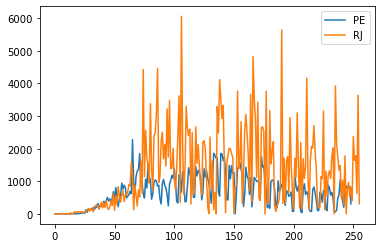

In [41]:
corona.plot();

In [42]:
# Tranasformado em uma função
# desde o 1 caso
# fazer interação dos estados
# try para tratar os erros
#

def desde1caso(data, estados, dias, situacao):

  corona = pd.DataFrame()

  for estado in estados:
    try:
      df_estado = data.loc[data.state==estado, :]
      df_estado = df_estado.groupby('date').sum()[situacao].reset_index()
      df_estado = df_estado.drop("date", axis=1)
      corona = pd.concat([corona, df_estado], ignore_index=True, axis=1)
    except:
      print("Is not " + situacao + " in " + estado )
  
  corona.columns = estados

  return corona.head(dias)

In [43]:
# executando a função
df_estados = desde1caso(data,['PE'], 50,'new_deaths')

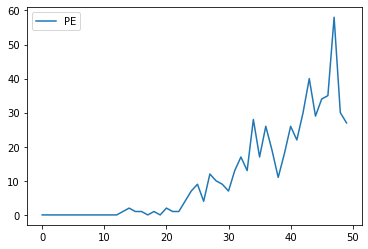

In [44]:
df_estados.plot();

In [45]:
# executando a função
df_estados = desde1caso(data,['PE'], 50,'new_confirmed')

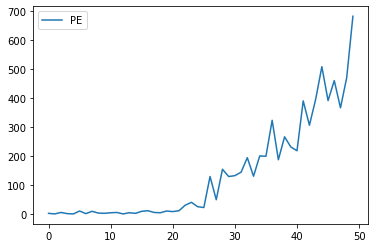

In [46]:
df_estados.plot();

In [47]:
# executando a função
df_estados = desde1caso(data,['PE','SP','RJ'], 50,'new_deaths')

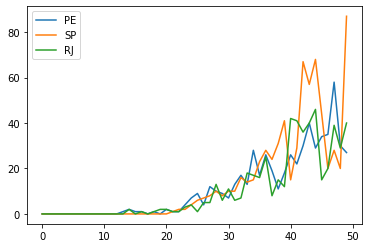

In [48]:
df_estados.plot();

# Correlação entre casos e mortes

In [49]:
df_corr = pd.DataFrame()

In [50]:
pe_new_confirmed = desde1caso(data,['PE'], 100,'new_confirmed')
pe_new_deaths    = desde1caso(data,['PE'], 100,'new_deaths')

In [51]:
# Concatenar pela colunas
df_corr = corona = pd.concat([df_corr, pe_new_confirmed, pe_new_deaths ], ignore_index=True, axis=1)
df_corr.columns = ['new_confirmed', 'new_deaths']

In [52]:
def correlacao_casos_mortes(data, estado, dias):
    df_corr         = pd.DataFrame()
    pe_new_confirmed    = desde1caso(data, estado, dias,'new_confirmed')
    pe_new_deaths         = desde1caso(data, estado, dias,'new_deaths')
    df_corr         = pd.concat([df_corr, pe_new_confirmed, pe_new_deaths ], ignore_index=True, axis=1)
    df_corr.columns = ['new_confirmed', 'new_deaths']
    
    return df_corr

In [53]:
df_corr = correlacao_casos_mortes(data, ['PE'], 100)

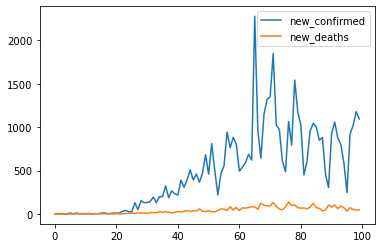

In [54]:
df_corr.plot();

In [55]:
df_corr.corr(method='pearson').round(4)

,new_confirmed,new_deaths
new_confirmed,1.000,0.811
new_deaths,0.811,1.000


In [56]:
# Correlação de spearman - leva em consideração  a correlação positiva e negativa
df_corr.corr('spearman').round(4)

,new_confirmed,new_deaths
new_confirmed,1.0000,0.8909
new_deaths,0.8909,1.0000


In [57]:
df_corr = correlacao_casos_mortes(data, ['SP'], 100)

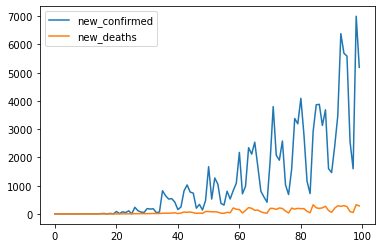

In [58]:
df_corr.plot();

In [59]:
df_corr.corr()

,new_confirmed,new_deaths
new_confirmed,1.000000,0.901758
new_deaths,0.901758,1.000000


In [60]:
estados

,city,city_ibge_code,date,epidemiological_week,estimated_population,estimated_population_2019,is_last,is_repeated,last_available_confirmed,last_available_confirmed_per_100k_inhabitants,last_available_date,last_available_death_rate,last_available_deaths,order_for_place,place_type,state,new_confirmed,new_deaths
1,NaN,35.0,2020-02-25,9,46289333.0,45919049.0,False,False,1,0.00216,2020-02-25,0.0000,0,1,state,SP,1,0
3,NaN,35.0,2020-02-26,9,46289333.0,45919049.0,False,False,1,0.00216,2020-02-26,0.0000,0,2,state,SP,0,0
5,NaN,35.0,2020-02-27,9,46289333.0,45919049.0,False,False,1,0.00216,2020-02-27,0.0000,0,3,state,SP,0,0
7,NaN,35.0,2020-02-28,9,46289333.0,45919049.0,False,False,2,0.00432,2020-02-28,0.0000,0,4,state,SP,1,0
9,NaN,35.0,2020-02-29,9,46289333.0,45919049.0,False,False,2,0.00432,2020-02-29,0.0000,0,5,state,SP,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1061198,NaN,43.0,2020-11-15,47,11422973.0,11377239.0,True,False,278707,2439.88146,2020-11-15,0.0223,6219,251,state,RS,1188,4
1061199,NaN,42.0,2020-11-15,47,7252502.0,7164788.0,True,False,295946,4080.60556,2020-11-15,0.0112,3318,249,state,SC,2144,9
1061200,NaN,28.0,2020-11-15,47,2318822.0,2298696.0,True,False,86045,3710.72036,2020-11-15,0.0263,2259,247,state,SE,65,2
1061201,NaN,35.0,2020-11-15,47,46289333.0,45919049.0,True,False,1168640,2524.64212,2020-11-15,0.0347,40564,265,state,SP,1218,15


In [61]:
ultimas = estados.loc[estados.is_last==True, ['state','new_confirmed']]

In [62]:
len(ultimas)

27

In [63]:
import folium
from folium import plugins
from matplotlib import cm

In [64]:
from branca.colormap import linear
import branca.colormap as cm
colormap = linear.YlOrRd_09.scale(0, 400)

colormap = cm.LinearColormap(
    ['blue', 'yellow', 'red'],
    vmin=0, vmax=500
)

colormap

In [65]:
import json

br_estados = 'br_states.json'
geo_json_data =json.load(open(br_estados))

In [66]:
ultimas_map = ultimas.set_index('state')['new_confirmed']

In [67]:
mapa =folium.Map(
    width=600, height=400,
    location =[-15.77972, -47.92972],
    zoom_start=4
)

In [68]:
folium.GeoJson(
    geo_json_data,
    name='CORONA_VIRUS',
    style_function = lambda feature: {
        'fillColor': colormap(ultimas_map[feature['id']]),
        'color': 'black',
        'weight': 0.9,
    }
    
).add_to(mapa)



#mapa.choropleth(
#    geo_data= geo_json_data,
#    name='CASOS',
 #   data =ultimas,
  #  columns =['state','new_confirmed'],
   # key_on = 'feature.id',
    #fill_collor ='Reds',
    #fill_opacity =0.8,
    #line_color ='white',
    #line_opacity = 0.8,
    #show =True,
    #legend_name = 'CASOS DE CORONA_VIRUS NO BRASIL'
    
#)

In [69]:
colormap.caption = 'Casos de Corona_Virus por Estados'
colormap.add_to(mapa)

In [70]:
mapa

In [71]:
mapa.save('corona-virus.html')

# Data Preparaçaõ

In [72]:
# seleciona os estados
cid= df.loc[df.place_type =='city', : ]
cid.place_type.unique()

array(['city'], dtype=object)

In [73]:
len(cid)

1054503

In [74]:
# Junta as duas base de dados
# junta o index da primeira tabela
cid =cid.join(cidades, on='city_ibge_code')

In [75]:
cid.head()

,city,city_ibge_code,date,epidemiological_week,estimated_population,estimated_population_2019,is_last,is_repeated,last_available_confirmed,last_available_confirmed_per_100k_inhabitants,last_available_date,last_available_death_rate,last_available_deaths,order_for_place,place_type,state,new_confirmed,new_deaths,nome,latitude,longitude,capital,codigo_uf
0,São Paulo,3550308.0,2020-02-25,9,12325232.0,12252023.0,False,False,1,0.00811,2020-02-25,0.0,0,1,city,SP,1,0,São Paulo,-23.5329,-46.6395,1.0,35.0
2,São Paulo,3550308.0,2020-02-26,9,12325232.0,12252023.0,False,False,1,0.00811,2020-02-26,0.0,0,2,city,SP,0,0,São Paulo,-23.5329,-46.6395,1.0,35.0
4,São Paulo,3550308.0,2020-02-27,9,12325232.0,12252023.0,False,False,1,0.00811,2020-02-27,0.0,0,3,city,SP,0,0,São Paulo,-23.5329,-46.6395,1.0,35.0
6,São Paulo,3550308.0,2020-02-28,9,12325232.0,12252023.0,False,False,2,0.01623,2020-02-28,0.0,0,4,city,SP,1,0,São Paulo,-23.5329,-46.6395,1.0,35.0
8,São Paulo,3550308.0,2020-02-29,9,12325232.0,12252023.0,False,False,2,0.01623,2020-02-29,0.0,0,5,city,SP,0,0,São Paulo,-23.5329,-46.6395,1.0,35.0


In [76]:
# Novo dataframe
# selecionar colunas
geo_last = cid.loc[cid.is_last==True, ['city','latitude','longitude','state','new_confirmed','new_deaths']]

In [77]:
# ultimos casos
geo_last

,city,latitude,longitude,state,new_confirmed,new_deaths
513792,Acorizal,-15.19400,-56.3632,MT,4,0
513793,Alta Floresta,-9.86674,-56.0867,MT,32,1
513794,Alto Araguaia,-17.31530,-53.2181,MT,0,0
513795,Alto Boa Vista,-11.67320,-51.3883,MT,0,0
513796,Alto Garças,-16.94620,-53.5272,MT,3,1
...,...,...,...,...,...,...
1061032,Águas de São Pedro,-22.59770,-47.8734,SP,0,0
1061033,Álvares Florence,-20.32030,-49.9141,SP,0,0
1061034,Álvares Machado,-22.07640,-51.4722,SP,0,0
1061035,Álvaro de Carvalho,-22.08410,-49.7190,SP,0,0


In [78]:
# ultimos casos
len(geo_last)

5588

In [79]:
#total de casos
geo_last.new_confirmed.sum()

20125

In [80]:
#todos estados inseridos
geo_last.state.unique()

array(['MT', 'ES', 'PR', 'RJ', 'AM', 'AP', 'RR', 'SC', 'MS', 'RN', 'SE',
       'AC', 'RO', 'DF', 'PB', 'BA', 'CE', 'MA', 'MG', 'PA', 'TO', 'AL',
       'GO', 'PE', 'PI', 'RS', 'SP'], dtype=object)

In [81]:
coord =geo_last[['latitude','longitude','new_confirmed']]


In [82]:
# eliminar dados nan
coord =coord.dropna()

In [83]:
coord

,latitude,longitude,new_confirmed
513792,-15.19400,-56.3632,4
513793,-9.86674,-56.0867,32
513794,-17.31530,-53.2181,0
513795,-11.67320,-51.3883,0
513796,-16.94620,-53.5272,3
...,...,...,...
1061032,-22.59770,-47.8734,0
1061033,-20.32030,-49.9141,0
1061034,-22.07640,-51.4722,0
1061035,-22.08410,-49.7190,0


In [84]:
baseMap = folium.Map(
                width='100%',
                height='100%',
                location =[-15.77972, -47.92972],
                zoom_start=4
)

In [85]:
baseMap

In [86]:
# mapa de calor
baseMap = baseMap.add_child(plugins.HeatMap(coord))

In [87]:
baseMap

In [88]:
geo_last = geo_last.dropna()
geo_last

,city,latitude,longitude,state,new_confirmed,new_deaths
513792,Acorizal,-15.19400,-56.3632,MT,4,0
513793,Alta Floresta,-9.86674,-56.0867,MT,32,1
513794,Alto Araguaia,-17.31530,-53.2181,MT,0,0
513795,Alto Boa Vista,-11.67320,-51.3883,MT,0,0
513796,Alto Garças,-16.94620,-53.5272,MT,3,1
...,...,...,...,...,...,...
1061032,Águas de São Pedro,-22.59770,-47.8734,SP,0,0
1061033,Álvares Florence,-20.32030,-49.9141,SP,0,0
1061034,Álvares Machado,-22.07640,-51.4722,SP,0,0
1061035,Álvaro de Carvalho,-22.08410,-49.7190,SP,0,0


In [89]:
#selecionar pelo index
#geo_last.iloc[0]['latitude']

In [90]:
# colocar um circulo em cima das cidades
# fazer interação
# caixa de texto em html(tooltip)
# tamanho do circulo(radius)
# concatenar strigs
# str transforma em strigs
# multiplicar o tamanho por  1.1

for i in range(0, len (geo_last)):
    folium.Circle(
        location = [geo_last.iloc[i]['latitude'] , geo_last.iloc[i]['longitude']],
        color ='#00FF69',
        fill = '#00a1b3',
        tooltip = '<li><bold> CIDADE' + str(geo_last.iloc[i]['city']) +
                 '<li><bold> ESTADO' + str(geo_last.iloc[i]['state']) +
                '<li><bold> CASO' + str(geo_last.iloc[i]['new_confirmed']) +
                '<li><bold> MORTES' + str(geo_last.iloc[i]['new_deaths']) ,
        radius =(geo_last.iloc[i]['new_confirmed']**1.1)
        
).add_to(baseMap)

In [91]:
baseMap

In [92]:
baseMap.save('hetmap-cidade.html')

# Bar Chart Race Pandas

In [93]:
# Ler a base de dados
df_bar = pd.read_csv("caso_full.csv" , sep=',' , encoding='utf8') 

In [94]:
df_bar.head()

,city,city_ibge_code,date,epidemiological_week,estimated_population,estimated_population_2019,is_last,is_repeated,last_available_confirmed,last_available_confirmed_per_100k_inhabitants,last_available_date,last_available_death_rate,last_available_deaths,order_for_place,place_type,state,new_confirmed,new_deaths
0,São Paulo,3550308.0,2020-02-25,9,12325232.0,12252023.0,False,False,1,0.00811,2020-02-25,0.0,0,1,city,SP,1,0
1,NaN,35.0,2020-02-25,9,46289333.0,45919049.0,False,False,1,0.00216,2020-02-25,0.0,0,1,state,SP,1,0
2,São Paulo,3550308.0,2020-02-26,9,12325232.0,12252023.0,False,False,1,0.00811,2020-02-26,0.0,0,2,city,SP,0,0
3,NaN,35.0,2020-02-26,9,46289333.0,45919049.0,False,False,1,0.00216,2020-02-26,0.0,0,2,state,SP,0,0
4,São Paulo,3550308.0,2020-02-27,9,12325232.0,12252023.0,False,False,1,0.00811,2020-02-27,0.0,0,3,city,SP,0,0


In [98]:
# elimina dados ausentes dos estados
df_bar.dropna(subset=['city'], inplace=True)
df_bar.dropna(subset=['state'], inplace=True)

In [99]:
# Agrupamento por estado e data
# atribui a informação ao dateframe
#dedempilha pelo indice
# t =trampose

df_corona_bcr =pd.DataFrame(df_bar.groupby(['state','date']).sum()['new_confirmed']).unstack().T.droplevel(level=0)

In [100]:
df_corona_bcr

state,AC,AL,AM,AP,BA,CE,DF,ES,GO,MA,MG,MS,MT,PA,PB,PE,PI,PR,RJ,RN,RO,RR,RS,SC,SE,SP,TO
date,,,,,,,,,,,,,,,,,,,,,,,,,,,
2020-02-25,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN
2020-02-26,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN
2020-02-27,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN
2020-02-28,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN
2020-02-29,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-11-11,187.0,101.0,0.0,0.0,1728.0,667.0,423.0,0.0,860.0,364.0,0.0,0.0,0.0,869.0,611.0,860.0,590.0,0.0,0.0,0.0,302.0,0.0,3174.0,0.0,0.0,3421.0,222.0
2020-11-12,0.0,126.0,0.0,0.0,1590.0,2482.0,686.0,0.0,1422.0,371.0,4055.0,0.0,0.0,0.0,0.0,787.0,517.0,0.0,0.0,0.0,0.0,0.0,3590.0,0.0,0.0,5780.0,260.0
2020-11-13,0.0,162.0,0.0,0.0,2119.0,992.0,533.0,0.0,766.0,273.0,2737.0,0.0,0.0,1476.0,1302.0,830.0,484.0,0.0,0.0,0.0,0.0,0.0,3071.0,0.0,0.0,0.0,184.0


In [101]:
bcr.bar_chart_race(df_corona_bcr)